In [ ]:
!pip install datasets pandas pymongo sentence_transformers

In [ ]:
!pip install -U transformers accelerate

In [ ]:
from datasets import load_dataset

In [ ]:
import pandas as pd

In [ ]:
dataset=load_dataset("AIatMongoDB/embedded_movies")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split: 0 examples [00:00, ? examples/s]

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['type', 'rated', 'metacritic', 'plot', 'fullplot', 'plot_embedding', 'languages', 'awards', 'writers', 'directors', 'num_mflix_comments', 'countries', 'runtime', 'cast', 'poster', 'imdb', 'genres', 'title'],
        num_rows: 1500
    })
})

In [ ]:
dataset_df=pd.DataFrame(dataset["train"])

In [ ]:
dataset_df.head()

,type,rated,metacritic,plot,fullplot,plot_embedding,languages,awards,writers,directors,num_mflix_comments,countries,runtime,cast,poster,imdb,genres,title
0,movie,None,NaN,Young Pauline is left a lot of money when her ...,Young Pauline is left a lot of money when her ...,"[0.00072939653, -0.026834568, 0.013515796, -0....",[English],"{'nominations': 0, 'text': '1 win.', 'wins': 1}","[Charles W. Goddard (screenplay), Basil Dickey...","[Louis J. Gasnier, Donald MacKenzie]",0,[USA],199.0,"[Pearl White, Crane Wilbur, Paul Panzer, Edwar...",https://m.media-amazon.com/images/M/MV5BMzgxOD...,"{'id': 4465, 'rating': 7.6, 'votes': 744}",[Action],The Perils of Pauline
1,movie,TV-G,NaN,A penniless young man tries to save an heiress...,As a penniless man worries about how he will m...,"[-0.022837115, -0.022941574, 0.014937485, -0.0...",[English],"{'nominations': 1, 'text': '1 nomination.', 'w...",[H.M. Walker (titles)],"[Alfred J. Goulding, Hal Roach]",0,[USA],22.0,"[Harold Lloyd, Mildred Davis, 'Snub' Pollard, ...",https://m.media-amazon.com/images/M/MV5BNzE1OW...,"{'id': 10146, 'rating': 7.0, 'votes': 639}","[Comedy, Short, Action]",From Hand to Mouth
2,movie,None,NaN,"Michael ""Beau"" Geste leaves England in disgrac...","Michael ""Beau"" Geste leaves England in disgrac...","[0.00023330493, -0.028511643, 0.014653289, -0....",[English],"{'nominations': 0, 'text': '1 win.', 'wins': 1}","[Herbert Brenon (adaptation), John Russell (ad...",[Herbert Brenon],0,[USA],101.0,"[Ronald Colman, Neil Hamilton, Ralph Forbes, A...",None,"{'id': 16634, 'rating': 6.9, 'votes': 222}","[Action, Adventure, Drama]",Beau Geste
3,movie,None,NaN,"Seeking revenge, an athletic young man joins t...",A nobleman vows to avenge the death of his fat...,"[-0.005927917, -0.033394486, 0.0015323418, -0....",None,"{'nominations': 0, 'text': '1 win.', 'wins': 1}","[Douglas Fairbanks (story), Jack Cunningham (a...",[Albert Parker],1,[USA],88.0,"[Billie Dove, Tempe Pigott, Donald Crisp, Sam ...",https://m.media-amazon.com/images/M/MV5BMzU0ND...,"{'id': 16654, 'rating': 7.2, 'votes': 1146}","[Adventure, Action]",The Black Pirate
4,movie,PASSED,NaN,An irresponsible young millionaire changes his...,"The Uptown Boy, J. Harold Manners (Lloyd) is a...","[-0.0059373598, -0.026604708, -0.0070914757, -...",[English],"{'nominations': 1, 'text': '1 nomination.', 'w...","[Ted Wilde (story), John Grey (story), Clyde B...",[Sam Taylor],0,[USA],58.0,"[Harold Lloyd, Jobyna Ralston, Noah Young, Jim...",https://m.media-amazon.com/images/M/MV5BMTcxMT...,"{'id': 16895, 'rating': 7.6, 'votes': 918}","[Action, Comedy, Romance]",For Heaven's Sake


In [ ]:
dataset_df.columns

Index(['type', 'rated', 'metacritic', 'plot', 'fullplot', 'plot_embedding',
       'languages', 'awards', 'writers', 'directors', 'num_mflix_comments',
       'countries', 'runtime', 'cast', 'poster', 'imdb', 'genres', 'title'],
      dtype='object')

In [ ]:
dataset_df["plot"][0]

"Young Pauline is left a lot of money when her wealthy uncle dies. However, her uncle's secretary has been named as her guardian until she marries, at which time she will officially take ..."

In [ ]:
dataset_df["fullplot"][0]

'Young Pauline is left a lot of money when her wealthy uncle dies. However, her uncle\'s secretary has been named as her guardian until she marries, at which time she will officially take possession of her inheritance. Meanwhile, her "guardian" and his confederates constantly come up with schemes to get rid of Pauline so that he can get his hands on the money himself.'

In [ ]:
dataset_df["num_mflix_comments"][0]

0

In [ ]:
dataset_df[o"fullplt"].isnull().sum()

48

In [ ]:
dataset_df.shape

(1500, 18)

In [ ]:
dataset_df["poster"][0]

'https://m.media-amazon.com/images/M/MV5BMzgxODk1Mzk2Ml5BMl5BanBnXkFtZTgwMDg0NzkwMjE@._V1_SY1000_SX677_AL_.jpg'

In [ ]:
dataset_df["plot_embedding"][0]

In [ ]:
dataset_df.isnull().sum()

type                    0
rated                 308
metacritic            928
plot                   27
fullplot               48
plot_embedding         28
languages               1
awards                  0
writers                13
directors              13
num_mflix_comments      0
countries               0
runtime                15
cast                    1
poster                 89
imdb                    0
genres                  0
title                   0
dtype: int64

In [ ]:
dataset_df=dataset_df.dropna(subset=["fullplot"])

In [ ]:
dataset_df["fullplot"].isnull().sum()

0

In [ ]:
dataset_df = dataset_df.drop(columns=["plot_embedding"])

In [ ]:
dataset_df.head(2)

,type,rated,metacritic,plot,fullplot,languages,awards,writers,directors,num_mflix_comments,countries,runtime,cast,poster,imdb,genres,title
0,movie,None,NaN,Young Pauline is left a lot of money when her ...,Young Pauline is left a lot of money when her ...,[English],"{'nominations': 0, 'text': '1 win.', 'wins': 1}","[Charles W. Goddard (screenplay), Basil Dickey...","[Louis J. Gasnier, Donald MacKenzie]",0,[USA],199.0,"[Pearl White, Crane Wilbur, Paul Panzer, Edwar...",https://m.media-amazon.com/images/M/MV5BMzgxOD...,"{'id': 4465, 'rating': 7.6, 'votes': 744}",[Action],The Perils of Pauline
1,movie,TV-G,NaN,A penniless young man tries to save an heiress...,As a penniless man worries about how he will m...,[English],"{'nominations': 1, 'text': '1 nomination.', 'w...",[H.M. Walker (titles)],"[Alfred J. Goulding, Hal Roach]",0,[USA],22.0,"[Harold Lloyd, Mildred Davis, 'Snub' Pollard, ...",https://m.media-amazon.com/images/M/MV5BNzE1OW...,"{'id': 10146, 'rating': 7.0, 'votes': 639}","[Comedy, Short, Action]",From Hand to Mouth


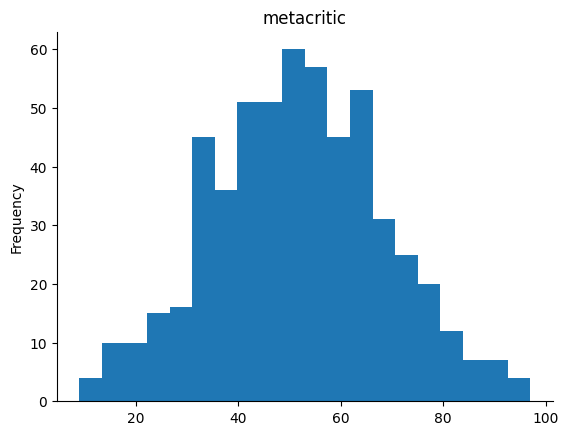

In [ ]:
# @title metacritic

from matplotlib import pyplot as plt
dataset_df['metacritic'].plot(kind='hist', bins=20, title='metacritic')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
from sentence_transformers import SentenceTransformer
embedding_model = SentenceTransformer("thenlper/gte-large")

In [ ]:
dataset_df["fullplot"][2]

'Michael "Beau" Geste leaves England in disgrace and joins the infamous French Foreign Legion. He is reunited with his two brothers in North Africa, where they face greater danger from their own sadistic commander than from the rebellious Arabs.'

In [ ]:
text="   sunny savita is  a data scientist who create prodcut of data"

In [ ]:
text="   sunny savita is  a data scientist who create prodcut of data     "


In [ ]:
text

'   sunny savita is  a data scientist who create prodcut of data     '

In [ ]:
text.strip()

'sunny savita is  a data scientist who create prodcut of data'

In [ ]:
def get_embedding(text:str)->list[float]:

  if not text.strip():
    print("attempted to get embedding for empty text.")
    return []

  embedding=embedding_model.encode(text)
  return embedding.tolist()


In [ ]:
dataset_df["embedding"]=dataset_df["fullplot"].apply(get_embedding)

In [ ]:
dataset_df.head(3)

,type,rated,metacritic,plot,fullplot,languages,awards,writers,directors,num_mflix_comments,countries,runtime,cast,poster,imdb,genres,title,embedding
0,movie,None,NaN,Young Pauline is left a lot of money when her ...,Young Pauline is left a lot of money when her ...,[English],"{'nominations': 0, 'text': '1 win.', 'wins': 1}","[Charles W. Goddard (screenplay), Basil Dickey...","[Louis J. Gasnier, Donald MacKenzie]",0,[USA],199.0,"[Pearl White, Crane Wilbur, Paul Panzer, Edwar...",https://m.media-amazon.com/images/M/MV5BMzgxOD...,"{'id': 4465, 'rating': 7.6, 'votes': 744}",[Action],The Perils of Pauline,"[-0.009285839274525642, -0.005062091629952192,..."
1,movie,TV-G,NaN,A penniless young man tries to save an heiress...,As a penniless man worries about how he will m...,[English],"{'nominations': 1, 'text': '1 nomination.', 'w...",[H.M. Walker (titles)],"[Alfred J. Goulding, Hal Roach]",0,[USA],22.0,"[Harold Lloyd, Mildred Davis, 'Snub' Pollard, ...",https://m.media-amazon.com/images/M/MV5BNzE1OW...,"{'id': 10146, 'rating': 7.0, 'votes': 639}","[Comedy, Short, Action]",From Hand to Mouth,"[-0.002439370146021247, 0.023095937445759773, ..."
2,movie,None,NaN,"Michael ""Beau"" Geste leaves England in disgrac...","Michael ""Beau"" Geste leaves England in disgrac...",[English],"{'nominations': 0, 'text': '1 win.', 'wins': 1}","[Herbert Brenon (adaptation), John Russell (ad...",[Herbert Brenon],0,[USA],101.0,"[Ronald Colman, Neil Hamilton, Ralph Forbes, A...",None,"{'id': 16634, 'rating': 6.9, 'votes': 222}","[Action, Adventure, Drama]",Beau Geste,"[0.012204294092953205, -0.011455751955509186, ..."


In [ ]:
dataset_df["embedding"][0]

[-0.009285839274525642,
 -0.005062091629952192,
 -0.010958134196698666,
 0.029197754338383675,
 -0.00320404558442533,
 0.0065294052474200726,
 -0.000519637658726424,
 0.034043774008750916,
 0.004956735298037529,
 -0.00538758235052228,
 0.028133049607276917,
 0.0058067599311470985,
 0.00850922241806984,
 -0.006339727900922298,
 -0.026832519099116325,
 0.0007219561957754195,
 -0.05201868712902069,
 -0.018970804288983345,
 -0.034679438918828964,
 -0.014942392706871033,
 0.021869556978344917,
 0.01353765930980444,
 -0.07247655838727951,
 -0.039808884263038635,
 -0.00570263434201479,
 0.03734813630580902,
 0.036971915513277054,
 -0.0009293120237998664,
 0.056134432554244995,
 0.04322363808751106,
 -0.01612459309399128,
 -0.018139785155653954,
 0.018382979556918144,
 -0.031032321974635124,
 -0.006974262185394764,
 -0.01916695013642311,
 0.04368211328983307,
 -0.0282314270734787,
 -0.0007613761117681861,
 -0.06701458990573883,
 0.014413016848266125,
 -0.021378563717007637,
 0.0578315183520317

In [ ]:
!python --version

Python 3.10.12


In [ ]:
import pymongo

In [ ]:
!python -m pip install "pymongo[srv]"


In [ ]:
!pip list

Package                          Version
-------------------------------- ---------------------
absl-py                          1.4.0
accelerate                       0.29.3
aiohttp                          3.9.5
aiosignal                        1.3.1
alabaster                        0.7.16
albumentations                   1.3.1
altair                           4.2.2
annotated-types                  0.6.0
anyio                            3.7.1
appdirs                          1.4.4
argon2-cffi                      23.1.0
argon2-cffi-bindings             21.2.0
array_record                     0.5.1
arviz                            0.15.1
astropy                          5.3.4
astunparse                       1.6.3
async-timeout                    4.0.3
atpublic                         4.1.0
attrs                            23.2.0
audioread                        3.0.1
autograd                         1.6.2
Babel                            2.14.0
backcall                         0.2.0


In [ ]:
from pymongo.mongo_client import MongoClient

In [ ]:
from google.colab import userdata
uri=userdata.get('MONGO_URI')

In [ ]:
# Create a new client and connect to the server
client = MongoClient(uri)

In [ ]:
# Send a ping to confirm a successful connection
try:
    client.admin.command('ping')
    print("Pinged your deployment. You successfully connected to MongoDB!")
except Exception as e:
    print(e)

Pinged your deployment. You successfully connected to MongoDB!


In [ ]:
def get_mongo_client(uri):
  try:
    client = MongoClient(uri)
    client.admin.command('ping')
    print("Pinged your deployment. You successfully connected to MongoDB!")
    return client
  except Exception as e:
    print(e)
    return None

In [ ]:
mongo_client=get_mongo_client(uri)

Pinged your deployment. You successfully connected to MongoDB!


In [ ]:
db=mongo_client["moviedb"]

In [ ]:
collection=db["moviecollection"]

In [ ]:
collection.insert_one({"name":"sunny",
                       "designation": "genai engineer",
                       "location":"bangaluru",
                       "mailid":"sunny.savita@ineuron.ai"})

InsertOneResult(ObjectId('6624b1196f3d00cb646ca827'), acknowledged=True)

In [ ]:
collection.insert_one({"name":"dipesh",
                       "designation": "ops manager",
                       "location":"bangaluru"})

InsertOneResult(ObjectId('6624b1b36f3d00cb646ca828'), acknowledged=True)

In [ ]:
collection2=db["moviecollectionsecond"]

In [ ]:
collection2.insert_one({"name":"krish",
                       "designation": "tech lead",
                       "location":"bangaluru",
                        "phonenumber":57454745834})

InsertOneResult(ObjectId('6624b2076f3d00cb646ca829'), acknowledged=True)

In [ ]:
collection.delete_many({})

DeleteResult({'n': 2, 'electionId': ObjectId('7fffffff000000000000001e'), 'opTime': {'ts': Timestamp(1713681008, 10), 't': 30}, 'ok': 1.0, '$clusterTime': {'clusterTime': Timestamp(1713681008, 11), 'signature': {'hash': b'|\xa4\xe6<\xcf\xb9L\x15q\\)|w\x07#\xf0\xe4\xc9\xbe\xc3', 'keyId': 7322590180760616966}}, 'operationTime': Timestamp(1713681008, 10)}, acknowledged=True)

In [ ]:
dataset_df.tail(3)

,type,rated,metacritic,plot,fullplot,languages,awards,writers,directors,num_mflix_comments,countries,runtime,cast,poster,imdb,genres,title,embedding
1497,movie,None,NaN,"Shakespeare's masterpiece ""Othello"" set in mod...",Advocate Raghunath Mishra has arranged the mar...,[Hindi],"{'nominations': 13, 'text': '14 wins & 13 nomi...","[Vishal Bhardwaj (screenplay), Robin Bhatt (sc...",[Vishal Bhardwaj],1,[India],155.0,"[Ajay Devgn, Kareena Kapoor, Saif Ali Khan, Ko...",https://m.media-amazon.com/images/M/MV5BY2NmNj...,"{'id': 488414, 'rating': 8.2, 'votes': 9800}","[Action, Crime, Drama]",Omkara,"[0.001624124008230865, -0.012888927012681961, ..."
1498,movie,R,NaN,When a small Colorado town is overrun by the f...,"In Leadville, Colorado, Captain Rhodes and his...",[English],"{'nominations': 1, 'text': '1 nomination.', 'w...","[Jeffrey Reddick (screenplay), George A. Romer...",[Steve Miner],1,[USA],86.0,"[Mena Suvari, Nick Cannon, Michael Welch, Anna...",https://m.media-amazon.com/images/M/MV5BNzg1Mj...,"{'id': 489018, 'rating': 4.5, 'votes': 17177}","[Action, Horror]",Day of the Dead,"[0.0051591419614851475, -0.007672053761780262,..."
1499,movie,PG-13,35.0,A teenager with teleportation abilities sudden...,David Rice is a high school student in Ann Arb...,"[English, Italian, Japanese, Mandarin]","{'nominations': 4, 'text': '2 wins & 4 nominat...","[David S. Goyer (screenplay), Jim Uhls (screen...",[Doug Liman],0,"[USA, Canada]",88.0,"[Hayden Christensen, Jamie Bell, Rachel Bilson...",https://m.media-amazon.com/images/M/MV5BMjEwOT...,"{'id': 489099, 'rating': 6.1, 'votes': 226607}","[Action, Adventure, Sci-Fi]",Jumper,"[-0.004183384124189615, -0.005530036520212889,..."


In [ ]:
dataset_df.to_dict()

{'type': {0: 'movie',
  1: 'movie',
  2: 'movie',
  3: 'movie',
  4: 'movie',
  5: 'movie',
  6: 'movie',
  7: 'movie',
  8: 'movie',
  9: 'movie',
  10: 'movie',
  11: 'movie',
  12: 'movie',
  13: 'movie',
  14: 'movie',
  15: 'movie',
  16: 'movie',
  17: 'movie',
  18: 'movie',
  19: 'movie',
  20: 'movie',
  21: 'movie',
  22: 'movie',
  23: 'movie',
  24: 'movie',
  25: 'movie',
  26: 'movie',
  27: 'movie',
  28: 'movie',
  29: 'movie',
  30: 'movie',
  31: 'movie',
  32: 'movie',
  33: 'movie',
  34: 'movie',
  35: 'movie',
  36: 'movie',
  37: 'movie',
  38: 'movie',
  39: 'movie',
  40: 'movie',
  41: 'movie',
  43: 'movie',
  44: 'movie',
  45: 'movie',
  46: 'movie',
  47: 'movie',
  48: 'movie',
  49: 'movie',
  50: 'movie',
  51: 'movie',
  52: 'movie',
  53: 'movie',
  55: 'movie',
  56: 'movie',
  57: 'movie',
  58: 'movie',
  59: 'movie',
  60: 'movie',
  61: 'movie',
  62: 'movie',
  64: 'movie',
  65: 'movie',
  66: 'movie',
  67: 'movie',
  68: 'movie',
  69: 'movie